In [1]:
import math
import os
import jax
jax.config.update("jax_enable_x64", True)
import s2fft
import healpy as hp
import numpy as np
import s2wav
import matplotlib.pyplot as plt
import skyclean as sc
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

## 1. Functions

In [2]:
def load_wavelet_scaling_coeffs(n_scales, realization, wav_template, frequency = None):
    wavelet_coeffs = [np.real(np.load(wav_template.format(frequency=frequency, scale=scale, realization=realization))) for scale in range(n_scales)]
    return wavelet_coeffs

def mw_alm_2_hp_alm(MW_alm, lmax):
    '''MW_alm: 2D array of shape (Lmax, 2*Lmax-1) (MW sampling, McEwen & Wiaux)
    '''
    # Initialize the 1D hp_alm array with the appropriate size
    hp_alm = np.zeros(hp.Alm.getsize(lmax), dtype=np.complex128)
        
    for l in range(lmax + 1):
        for m in range(-l, l + 1):
            index = hp.Alm.getidx(lmax, l, abs(m))
            if m < 0:
                hp_alm[index] = (-1)**m * np.conj(MW_alm[l, lmax + m])
            else:
                hp_alm[index] = MW_alm[l, lmax + m]

    return hp_alm


def hp_alm_2_mw_alm(hp_alm, L_max):
    """
    Converts spherical harmonics (alm) to a matrix representation for use in MW sampling.

    This function takes 1D Healpix spherical harmonics coefficients (alm) and converts them into a matrix form 
    that is in (MW sampling, McEwen & Wiaux) sampling. The matrix form is complex-valued 
    and indexed by multipole moment and azimuthal index.

    Parameters:
        hp_alm (numpy.ndarray): The input healpix spherical harmonics coefficients (alm).
        L_max (int): The maximum multipole moment to be represented in the output matrix.
    
    Note: # L_max = 4 | l = 0,1,2,3 , true lmax is L_max-1 = 3 | m = -3...0...(L_max-1 = 3)| number of m = 2(L_max-1)+1 = 2L_max-1

    Returns:
        MW_alm (numpy.ndarray): 2D array of shape (Lmax, 2*Lmax-1) MW spherical harmonics coefficients 
    """

    MW_alm = np.zeros((L_max, 2 * L_max - 1), dtype=np.complex128)

    for l in range(L_max):
        for m in range(-l, l + 1):
            index = hp.Alm.getidx(L_max - 1, l, abs(m))
            if m < 0:
                MW_alm[l, L_max + m - 1] = (-1) ** m * np.conj(hp_alm[index])
            else:
                MW_alm[l, L_max + m - 1] = hp_alm[index]

    return MW_alm

def MW_to_hp_map(MW_Pix_Map, is_MW_alm = False): 
    if not is_MW_alm:
        # The newly generated wavelet coefficient map is in three dimensions
        if len(MW_Pix_Map.shape) == 3:
            L_max = MW_Pix_Map.shape[1]
        else:
            L_max = MW_Pix_Map.shape[0]
        map_alm = s2fft.forward(MW_Pix_Map, L=L_max)
        #print("MW alm shape:", original_map_alm.shape)
    else:
        original_map_alm = MW_Pix_Map
        L_max = original_map_alm.shape[0]
    map_hp_alm = mw_alm_2_hp_alm(map_alm, L_max - 1)
    hp_map = hp.alm2map(map_hp_alm, nside=(L_max - 1)//2)
    return hp_map
    
    


def visualize_MW_Pix_map(MW_Pix_map, title, fig=plt.figure(), nrows=1, ncols=1, panel=1, coord=["G"], unit = r"K", is_MW_alm = False):
    """
    Processes a MW pixel wavelet coefficient map and visualizes it using HEALPix mollview.

    Parameters:
        MW_Pix_Map (numpy array): Array representing the wavelet coefficient map.
        title (str): Title for the visualization plot.

    Returns:
        Only Displays a mollview map.
    """
    original_hp_map = MW_to_hp_map(MW_Pix_map, is_MW_alm)
    hp.mollview(
    original_hp_map,
    fig=fig.number,
    sub=(nrows, ncols, panel),
    title=title,
    unit="K",
    cbar=False)
    # plt.figure(dpi=1200)

<Figure size 640x480 with 0 Axes>

## 2. Maps

KeyboardInterrupt: 

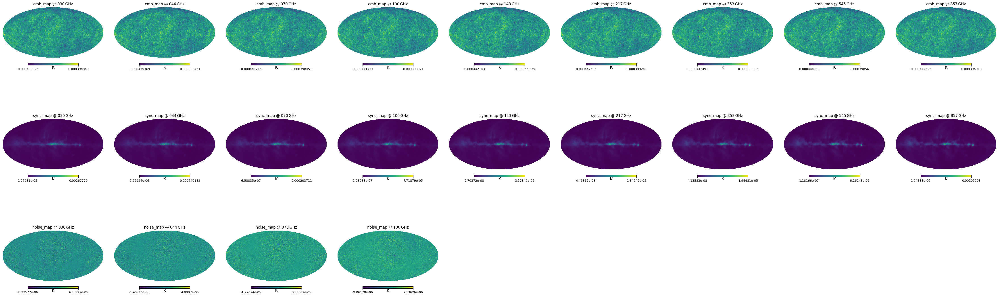

In [8]:
def visualize_maps(frequencies,
                  realization, desired_lmax,
                  file_templates):
    # setup figure
    nrows = len(list(file_templates.keys()))
    ncols = len(frequencies)
    fig = plt.figure(figsize=(5*ncols, 5*nrows))
    for i,(comp,file_template) in enumerate(file_templates.items()):
        for j, freq in enumerate(frequencies):
            fp = file_template.format(freq=freq, desired_lmax = desired_lmax, realization = realization)
            hp_map, _ = hp.read_map(fp, h=True)
            panel = j + i*ncols + 1
            if comp == "sync_map": # plot log scale for sync
                hp.mollview(
                    hp_map,
                    fig=fig.number,
                    sub=(nrows, ncols, panel),
                    title=f"{comp} @ {freq} GHz",
                    unit="K",
                    cbar=True       
                )
            else:
                hp.mollview(
                hp_map,
                fig=fig.number,
                sub=(nrows, ncols, panel),
                title=f"{comp} @ {freq} GHz",
                unit="K",
                cbar=True      
                )
        #cb = fig.colorbar(hp.graticule(), ax=fig.axes, orientation="horizontal", fraction=0.05, pad=0.07)
    plt.tight_layout()
    #plt.savefig('components.pdf', dpi=1400)
    plt.show()



frequencies = ["030", "044", "070", "100", "143", "217", "353", "545", "857"]
root_dir = "data/CMB_total"
file_templates = {
    'cmb_map': os.path.join(root_dir, "CMB_HP_Map_F{freq}_L{desired_lmax}_R{realization:04d}.fits"),
    'sync_map': os.path.join(root_dir, "Synchrotron_HP_Map_F{freq}_L{desired_lmax}_R{realization:04d}.fits"),
    'noise_map': os.path.join(root_dir, "Noise_HP_Map_F{freq}_L{desired_lmax}_R{realization:04d}.fits"),
    'csn_map': os.path.join(root_dir, "CSN_HP_Map_F{freq}_L{desired_lmax}_R{realization:04d}.fits")
}
visualize_maps(frequencies, realization=0, desired_lmax=256, file_templates=file_templates)

## 3. MW Wavelet Coefficient maps

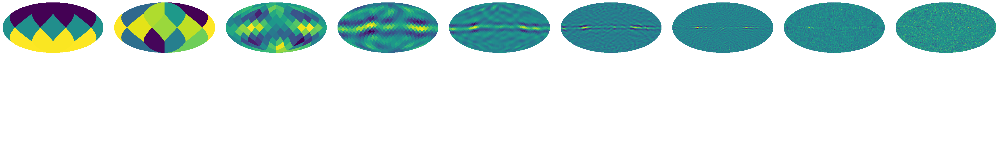

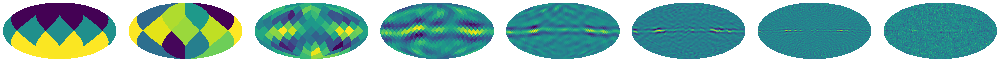

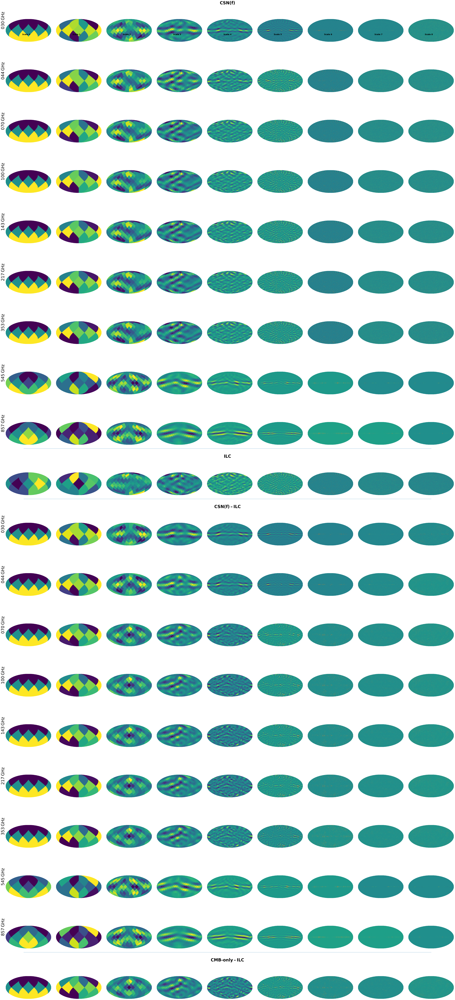

In [19]:
def visualize_wavelet_maps(realization, frequencies, scales, file_templates):
    n_freq   = len(frequencies)
    n_scales = len(scales)
    # four blocks: CMB_total (n_freq), ILC (1), CMB–ILC (n_freq), CMB-only–ILC (1)
    nrows = 2*n_freq + 2
    ncols = n_scales

    fig = plt.figure(figsize=(5*ncols, 5*nrows))
    fig.subplots_adjust(top=0.90, left=0.12, right=0.98, hspace=0.3)

    # 1) CMB_total block
    csn_dict = {}
    for i, freq in enumerate(frequencies):
        coeffs = load_wavelet_scaling_coeffs(
            n_scales, realization,
            file_templates['csn_wavelet_maps'], freq
        )
        csn_dict[freq] = coeffs
        for j, scale in enumerate(scales):
            panel = i*ncols + j + 1
            visualize_MW_Pix_map(
                coeffs[scale],
                title="",   # per‐cell titles cleared
                fig=fig, nrows=nrows, ncols=ncols, panel=panel
            )

    # 2) ILC row
    ilc_coeffs = load_wavelet_scaling_coeffs(
        n_scales, realization,
        file_templates['ilc_wavelet_maps'], None
    )
    ilc_row = n_freq
    for j, scale in enumerate(scales):
        panel = ilc_row*ncols + j + 1
        visualize_MW_Pix_map(
            ilc_coeffs[scale],
            title="", fig=fig, nrows=nrows, ncols=ncols, panel=panel
        )

    # 3) CMB_total–ILC block
    for i, freq in enumerate(frequencies):
        diff_row   = n_freq + 1 + i
        coeffs     = csn_dict[freq]
        for j, scale in enumerate(scales):
            panel = diff_row*ncols + j + 1
            diff_map = coeffs[scale] - ilc_coeffs[scale]
            visualize_MW_Pix_map(
                diff_map,
                title="", fig=fig, nrows=nrows, ncols=ncols, panel=panel
            )

    # 4) CMB-only–ILC bottom row (first freq)
    cmb_only = load_wavelet_scaling_coeffs(
        n_scales, realization,
        file_templates['cmb_only_wavelet_maps'], frequencies[0]
    )
    bottom = 2*n_freq + 1
    for j, scale in enumerate(scales):
        panel = bottom*ncols + j + 1
        diff  = cmb_only[scale] - ilc_coeffs[scale]
        visualize_MW_Pix_map(
            diff,
            title="", fig=fig, nrows=nrows, ncols=ncols, panel=panel
        )

    

    # — Column titles at top —
    for j, scale in enumerate(scales):
        x = (j + 0.5)/ncols
        fig.text(
            x, 0.96,
            f"Scale {scale}",
            ha='center', va='bottom',
            fontsize=14, fontweight='bold'
        )

    # — titles at top of each block —
    blocks = [
        (0,              "CSN(f)"),
        (n_freq,         "ILC"),
        (n_freq+1,       "CSN(f) – ILC"),
        (2*n_freq+1,     "CMB-only – ILC"),
    ]
    pad = 1.0/nrows * 0.2  # small vertical padding
    for start, title in blocks:
        y_edge  = 1 - start/nrows
        y_title = y_edge - pad
        fig.text(
            0.5, y_title,
            title,
            ha='center', va='bottom',
            fontsize=30, fontweight='bold'
        )

    # — Horizontal separators —
    for boundary in [n_freq-1, n_freq, 2*n_freq]:
        y = 1 - (boundary+1)/nrows
        line = Line2D([0.05, 0.95], [y, y],
                      transform=fig.transFigure,
                      linestyle='--', linewidth=1)
        fig.add_artist(line)

    # — Vertical frequency labels for blocks 1, 3 —
    # Block 1 (CMB Total)
    for i, freq in enumerate(frequencies):
        y = 1.0 - (i + 0.5)/nrows
        fig.text(
            0, y,
            f"{freq} GHz",
            va='center', ha='left',
            rotation='vertical', fontsize=30
        )
    # Block 3 (CMB–ILC)
    for i, freq in enumerate(frequencies):
        row = n_freq + 1 + i
        y   = 1.0 - (row + 0.5)/nrows
        fig.text(
            0, y,
            f"{freq} GHz",
            va='center', ha='left',
            rotation='vertical', fontsize=30
        )

    plt.show()





scales = range(9)
frequencies = ["030", "044", "070", "100", "143", "217", "353", "545", "857"]
realization = 0
file_templates = {
    'csn_wavelet_maps': "data/wavelet_transform/CSN/wavelets/wav_MW_maps/Wav_MW_Pix_F{frequency}_S{scale}_R{realization:04d}.npy",
    'ilc_wavelet_maps': "data/ILC/ILC_processed_wavelet_maps/ILC_processed_wav_Map_S{scale}_R{realization:04d}_MP.npy",
    'cmb_only_wavelet_maps': "data/wavelet_transform/CMB/wavelets/wav_MW_maps/Wav_MW_Pix_F{frequency}_S{scale}_R{realization:04d}.npy"
}
visualize_wavelet_maps(realization, frequencies, scales, file_templates)

            

## 4. Power Spectra

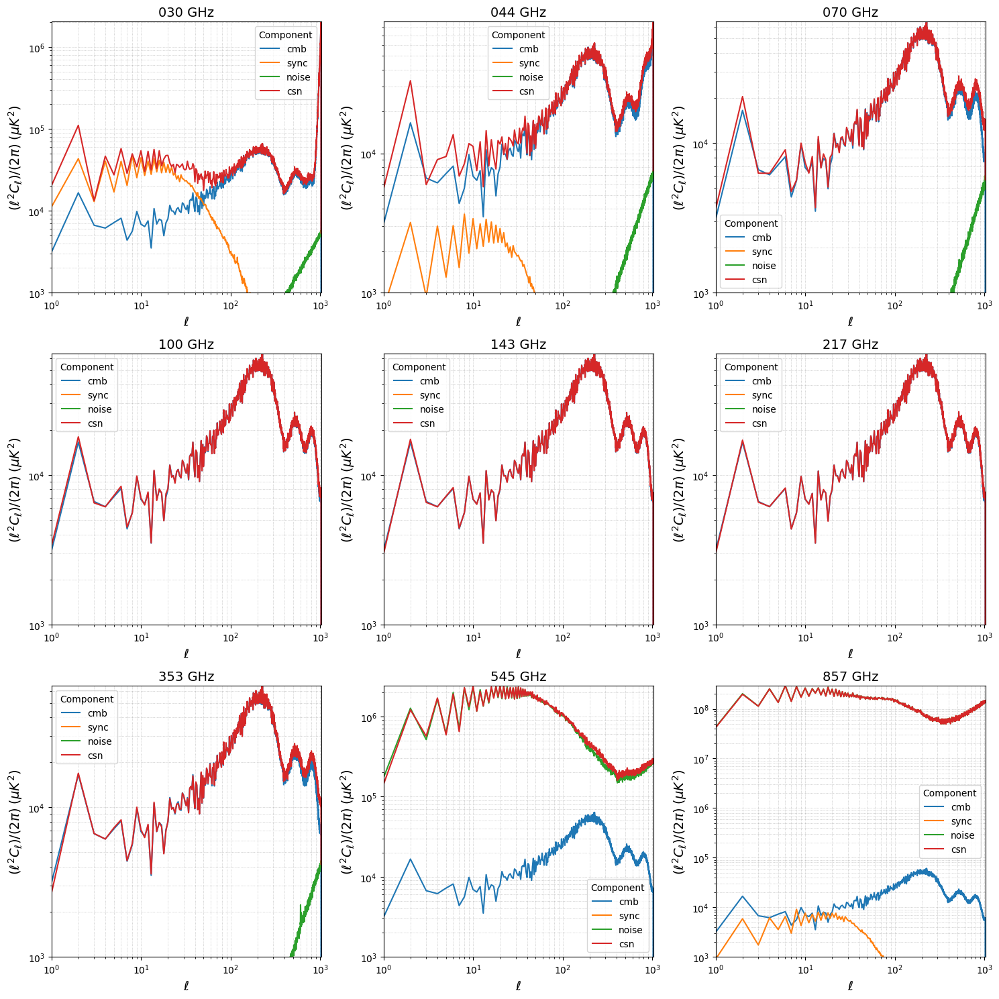

In [26]:

def visualize_power_spectra(frequencies, realization, desired_lmax, file_templates):
    """
    Arrange one subplot per frequency (max 3 columns per row) in a single figure,
    plotting C_ell for every component (including frequency-independent ILC).
    The ILC map is loaded only once (at the first frequency) via `if idx==0`.
    """
    # build color map for components
    colours   = plt.rcParams['axes.prop_cycle'].by_key()['color']
    components = list(file_templates.keys())
    comp_color = {
        comp: colours[i % len(colours)]
        for i, comp in enumerate(components)
    }

    # layout: at most 3 columns
    n_freq = len(frequencies)
    ncols  = min(3, n_freq)
    nrows  = math.ceil(n_freq / 3)

    fig, axes = plt.subplots(
        nrows, ncols,
        figsize=(5 * ncols, 5 * nrows),
        squeeze=False
    )
    axes_flat = axes.flatten()

    # loop on frequencies
    for i, freq in enumerate(frequencies):
        ax = axes_flat[i]
        ax.set_xscale('log')
        ax.set_yscale('log')
        ax.set_xlim(1, desired_lmax)
        ax.set_xlabel(r'$\ell$', fontsize = 14)
        ax.set_ylabel(r'$(\ell^2 C_\ell)/(2\pi)$ ($\mu K^2$)', fontsize = 14)
        ax.set_title(f"{freq} GHz", fontsize=14)

        for comp, template in file_templates.items():
            color = comp_color[comp]

            if comp == 'ilc':
                # load ILC only once at the first frequency
                if i == 0:
                    fp      = template.format(realization=realization)
                    mw_map  = np.load(fp)
                    hp_ilc  = MW_to_hp_map(mw_map)*1E6 # convert to micro K
                hp_map = hp_ilc
            else:
                fp = template.format(
                    freq=freq,
                    desired_lmax=desired_lmax,
                    realization=realization
                )
                hp_map, _ = hp.read_map(fp, h=True)
                hp_map*=1E6
            cl  = hp.sphtfunc.anafast(hp_map, lmax=desired_lmax)
            ell = np.arange(len(cl))
            ell_sq_cl = (ell*(ell+1)*cl)/2*np.pi

            ax.plot(
                ell, ell_sq_cl,
                label=comp,
                color=color,
                linewidth=1.5
            )
            ax.set_ylim(1E3,np.max(ell_sq_cl))

        ax.legend(title="Component", fontsize=10)
        ax.grid(True, which='both', linestyle=':', linewidth=0.5)

    # hide any unused subplots
    for ax in axes_flat[n_freq:]:
        ax.set_visible(False)

    plt.tight_layout()
    plt.savefig('power_spectra.pdf')
    plt.show()


# Example usage
root_dir = "data/CMB_total"
file_templates = {
    #'conv_cmb':  os.path.join(root_dir,  "old_CMB_HP_Map_F{freq}_L{desired_lmax}_R{realization:04d}.fits"), 
    'cmb':   os.path.join(root_dir,  "CMB_HP_Map_F{freq}_L{desired_lmax}_R{realization:04d}.fits"),
    'sync':  os.path.join(root_dir,  "Synchrotron_HP_Map_F{freq}_L{desired_lmax}_R{realization:04d}.fits"),
    'noise': os.path.join(root_dir,  "Noise_HP_Map_F{freq}_L{desired_lmax}_R{realization:04d}.fits"),
    'csn':   os.path.join(root_dir,  "CSN_HP_Map_F{freq}_L{desired_lmax}_R{realization:04d}.fits"),
    #'ilc':   "data/ILC/synthesized_ILC_MW_maps/ILC_MW_Map_R{realization:04d}.npy"
}

frequencies = ["030", "044", "070", "100", "143", "217", "353", "545", "857"]
visualize_power_spectra(
    frequencies,
    realization=0,
    desired_lmax=1024,
    file_templates=file_templates
)



In [ ]:
def visualize_ratio_power_spectra(frequencies, realization, desired_lmax, file_templates):
    """
    For each frequency:
      1) load the frequency-independent ILC Healpix map, compute its Cl
      2) load the CMB-only Healpix map for that frequency, compute its Cl
      3) take the ratio Cl_CMB / Cl_ILC and plot it
    
    Arranges the per-frequency ratio spectra in a single figure with up to
    3 columns per row.
    """
    # --- 1) compute Cℓ for ILC (once) ---
    ilc_fp = file_templates['ilc'].format(realization=realization)
    mw_ilc = np.load(ilc_fp)
    hp_ilc = MW_to_hp_map(mw_ilc)
    cl_ilc = hp.sphtfunc.anafast(hp_ilc, lmax=desired_lmax)

    ell = np.arange(len(cl_ilc))

    # --- grid geometry: ≤3 columns across ---
    n_freq = len(frequencies)
    ncols  = min(3, n_freq)
    nrows  = math.ceil(n_freq / ncols)

    fig, axes = plt.subplots(
        nrows, ncols,
        figsize=(5*ncols, 4*nrows),
        squeeze=False
    )
    axes_flat = axes.flatten()

    # --- 2) loop over frequencies ---
    for idx, freq in enumerate(frequencies):
        ax = axes_flat[idx]

        # load CMB-only map for this frequency
        cmb_fp = file_templates['cmb'].format(
            freq=freq,
            desired_lmax=desired_lmax,
            realization=realization
        )
        hp_cmb, _ = hp.read_map(cmb_fp, h=True)

        # compute its Cl
        cl_cmb = hp.sphtfunc.anafast(hp_cmb, lmax=desired_lmax)

        # ratio of power spectra
        cl_ratio = cl_cmb / cl_ilc

        # plot
        ax.plot(ell, cl_ratio, linewidth=1.5)
        ax.set_xscale('log')
        #ax.set_yscale('log')
        ax.set_xlim(1, desired_lmax)
        ax.set_ylim(0.1,10)
        ax.set_xlabel(r'$\ell$')
        ax.set_ylabel(r'$C_\ell^\mathrm{CMB}/C_\ell^\mathrm{ILC}$')
        ax.set_title(f"{freq} GHz")
        ax.axhline(1, ls =':', color='red')
        ax.grid(True, which='both', linestyle=':', linewidth=0.5)

    # hide any unused subplots
    for ax in axes_flat[n_freq:]:
        ax.set_visible(False)

    plt.tight_layout()
    plt.show()


# Example usage
root_dir = "data/CMB_total"
file_templates = {
    'cmb': os.path.join(
        root_dir,
        "CMB_HP_Map_F{freq}_L{desired_lmax}_R{realization:04d}.fits"
    ),
    'sync':  os.path.join(root_dir, "Synchrotron_HP_Map_F{freq}_L{desired_lmax}_R{realization:04d}.fits"),
    'noise': os.path.join(root_dir, "Noise_HP_Map_F{freq}_L{desired_lmax}_R{realization:04d}.fits"),
    'csn':   os.path.join(root_dir, "CSN_HP_Map_F{freq}_L{desired_lmax}_R{realization:04d}.fits"),
    'ilc':   "data/ILC/synthesized_ILC_MW_maps/ILC_MW_Map_R{realization:04d}.npy"
}

frequencies = ["030", "044", "070", "100", "143", "217", "353", "545", "857"]
visualize_ratio_power_spectra(
    frequencies,
    realization=0,
    desired_lmax=256,
    file_templates=file_templates
)